# Importing the required Libraries

In [1]:
import pandas as pd # to handle the dataset
import numpy as np # to manipulate the data
import matplotlib.pyplot as plt # to visualise the result of our model

import pandas_datareader as pdr #to get the data from the tiingo(website to get the uptodate data of the stocks, forex and manymore)

import nltk # natural language toolkit for stopwords and more
from nltk.corpus import stopwords # to remove unnecessary words
from nltk.stem.porter import PorterStemmer # to get the stem of the words

import re # regular expression to clean the data

from tensorflow.keras.layers import Embedding #to create the Embedding matrix
from tensorflow.keras.layers import LSTM # predicting using the Long Short Term Memory model
from tensorflow.keras.layers import Dropout #for the regularization(handling the overfitting)
from tensorflow.keras.layers import Dense #to create the output layer
from tensorflow.keras.models import Sequential # for creating the sequential model
from tensorflow.keras.preprocessing.text import one_hot # to create the one_hot representation of the words
from tensorflow.keras.preprocessing.sequence import pad_sequences # inorder to make all the sentences of the same length by adding some padding to them

from sklearn.preprocessing import MinMaxScaler # for Normalising the dataset
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report,mean_squared_error #performance metrics to observe the performance of the model
import math # to calculate some of the square root operation for the root mean square error

# Importing the dataset

##### Downloading the dataset first

In [2]:
# we need create the account in the Tiingo and we will be provided the key(which is in the document section) inorder to access the data(In a day we can access 50 data).
my_key = '################' # it is secured key so I have removed from here

In [3]:
# Downloading the stock price of the APPL for the analysis
data = pdr.get_data_tiingo('AAPL', api_key = my_key)

In [4]:
#printing the top 5 records in the dataset
data.head()

close    high       low    open    volume  \
symbol date                                                                    
AAPL   2015-12-21 00:00:00+00:00  107.33  107.37  105.5700  107.28  47590610   
       2015-12-22 00:00:00+00:00  107.23  107.72  106.4510  107.40  32789367   
       2015-12-23 00:00:00+00:00  108.61  108.85  107.2000  107.27  32657354   
       2015-12-24 00:00:00+00:00  108.03  109.00  107.9500  109.00  13596680   
       2015-12-28 00:00:00+00:00  106.82  107.69  106.1807  107.59  26704210   

                                   adjClose    adjHigh     adjLow    adjOpen  \
symbol date                                                                    
AAPL   2015-12-21 00:00:00+00:00  24.856402  24.865666  24.448807  24.844823   
       2015-12-22 00:00:00+00:00  24.833244  24.946722  24.652836  24.872614   
       2015-12-23 00:00:00+00:00  25.152836  25.208417  24.826296  24.842507   
       2015-12-24 00:00:00+00:00  25.018514  25.243155  24.999987  25.243155   
       2015-12-28 00:00:00+00:00  24.738292  24.939774  24.590238  24.916616   

                                  adjVolume  divCash  splitFactor  
symbol date                                                        
AAPL   2015-12-21 00:00:00+00:00  190362440      0.0          1.0  
       2015-12-22 00:00:00+00:00  131157468      0.0          1.0  
       2015-12-23 00:00:00+00:00  130629416      0.0          1.0  
       2015-12-24 00:00:00+00:00   54386720      0.0          1.0  
       2015-12-28 00:00:00+00:00  106816840      0.0          1.0

In [5]:
# Saving the downloaded data in the csv(comma separated value) inorder to make the task easier for the future
data.to_csv('AAPL')

##### Loading the dataset from the file now

In [6]:
df = pd.read_csv('AAPL') # loading the data

In [7]:
#printinting the top 5 elements of the dataset
df.head()

,symbol,date,close,high,low,open,volume,adjClose,adjHigh,adjLow,adjOpen,adjVolume,divCash,splitFactor
0,AAPL,2015-12-21 00:00:00+00:00,107.33,107.37,105.5700,107.28,47590610,24.856402,24.865666,24.448807,24.844823,190362440,0.0,1.0
1,AAPL,2015-12-22 00:00:00+00:00,107.23,107.72,106.4510,107.40,32789367,24.833244,24.946722,24.652836,24.872614,131157468,0.0,1.0
2,AAPL,2015-12-23 00:00:00+00:00,108.61,108.85,107.2000,107.27,32657354,25.152836,25.208417,24.826296,24.842507,130629416,0.0,1.0
3,AAPL,2015-12-24 00:00:00+00:00,108.03,109.00,107.9500,109.00,13596680,25.018514,25.243155,24.999987,25.243155,54386720,0.0,1.0
4,AAPL,2015-12-28 00:00:00+00:00,106.82,107.69,106.1807,107.59,26704210,24.738292,24.939774,24.590238,24.916616,106816840,0.0,1.0


In [8]:
#chcking the tail of the data to see it is latest data or not
df.tail()

,symbol,date,close,high,low,open,volume,adjClose,adjHigh,adjLow,adjOpen,adjVolume,divCash,splitFactor
1254,AAPL,2020-12-14 00:00:00+00:00,121.780,123.35,121.540,122.60,79075988,121.780,123.35,121.540,122.60,79075988,0.0,1.0
1255,AAPL,2020-12-15 00:00:00+00:00,127.880,127.90,124.130,124.34,157572262,127.880,127.90,124.130,124.34,157572262,0.0,1.0
1256,AAPL,2020-12-16 00:00:00+00:00,127.810,128.37,126.560,127.41,98208591,127.810,128.37,126.560,127.41,98208591,0.0,1.0
1257,AAPL,2020-12-17 00:00:00+00:00,128.700,129.58,128.045,128.90,94359811,128.700,129.58,128.045,128.90,94359811,0.0,1.0
1258,AAPL,2020-12-18 00:00:00+00:00,126.655,129.10,126.120,128.96,192541496,126.655,129.10,126.120,128.96,192541496,0.0,1.0


Today is 2020-12-18 and We have the data till the 2020-12-17. Our data is uptodata

# Data cleaning

In [9]:
#checking the missing value
df.isnull().sum()

symbol         0
date           0
close          0
high           0
low            0
open           0
volume         0
adjClose       0
adjHigh        0
adjLow         0
adjOpen        0
adjVolume      0
divCash        0
splitFactor    0
dtype: int64

###### I am going to take the feature 'close' and perform the time series analysis based on it

In [10]:
#selecting the close feature
df = df['close']

In [11]:
# printing the data
df

0       107.330
1       107.230
2       108.610
3       108.030
4       106.820
         ...   
1254    121.780
1255    127.880
1256    127.810
1257    128.700
1258    126.655
Name: close, Length: 1259, dtype: float64

###### I am going to use the LSTM so I need to normalize the data

In [12]:
scaler = MinMaxScaler() # initialising the dataset
df = scaler.fit_transform(np.array(df).reshape(-1,1)) # reshaping the dataset and applying the normalization
df #printing  the normalized data

array([[0.0408659 ],
       [0.04062538],
       [0.04394468],
       ...,
       [0.09012628],
       [0.09226699],
       [0.08734817]])

## Important:-
> In the time series analysis we cannot use train_test_split like in the other datasets because
   - We need to keep our data in order
   - if we select randomly than it will be violeted
   - we can use cross validation but we need to be carefull beacause there is a different technique to apply cross validation for time series data
        - we need to take the data until some date(let us say x) and we will predict for y days in the first then
        - we will take the training data of x+y and test another y data after x+y. It will be easily understandable from the figure below

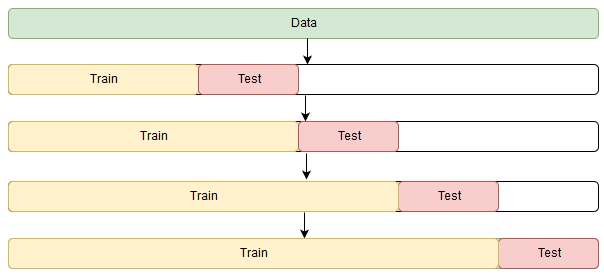

Here I am going to convert 67% of date to training and remaining to the testing

In [13]:
training_data_size = int(len(df)*0.67) # calculating the 67% of the data
training_df = df[0:training_data_size,:] # creating the train data of 67% of the total data
test_df = df[training_data_size:len(df),:1] # creating the test data or simply assigning the remaining data as the test data

In [14]:
training_df.shape, test_df.shape

((843, 1), (416, 1))

In [15]:
training_df

array([[0.0408659 ],
       [0.04062538],
       [0.04394468],
       [0.04254961],
       [0.03963921],
       [0.04425737],
       [0.04084185],
       [0.03588695],
       [0.03610343],
       [0.02975346],
       [0.02491882],
       [0.01469633],
       [0.01592303],
       [0.01969934],
       [0.02313891],
       [0.01695731],
       [0.02208058],
       [0.01633193],
       [0.01520144],
       [0.01551413],
       [0.01433554],
       [0.02665063],
       [0.02188815],
       [0.02321106],
       [0.0074083 ],
       [0.00901984],
       [0.01683704],
       [0.01464823],
       [0.00995791],
       [0.0144558 ],
       [0.01505713],
       [0.00885147],
       [0.01123271],
       [0.01118461],
       [0.0094528 ],
       [0.00808178],
       [0.00877931],
       [0.01515334],
       [0.01871317],
       [0.01423933],
       [0.01371016],
       [0.01573061],
       [0.01046302],
       [0.01385448],
       [0.01544197],
       [0.01580277],
       [0.0152736 ],
       [0.024

In [16]:
# function to convert an array of values into a dataset matrix
def create_dataset(dataset, timestamp = 1):
    X, y =[],[] # creating the empty list
    for i in range(len(dataset)-timestamp-1):
        a = dataset[i:i+timestamp,0] # extracting value from the array till the timestamp
        X.append(a) # appending the extracted value to the list
        y.append(dataset[timestamp+i,0]) # adding the value at the position timestamp+1 as the output variable
    return np.array(X), np.array(y) #returning the X and y array

In [17]:
timestamp_size = 100  # we are making the matrix of 100 feature
X_train,y_train = create_dataset(training_df, timestamp_size) # calling the function to create the dataset matrix of the training data
X_test, y_test = create_dataset(test_df, timestamp_size) # calling the function to create the dataset matrix of the testing data

In [18]:
#printing the number of rows and columns present in the training dataset matrix
X_train.shape,y_train.shape

((742, 100), (742,))

In [19]:
# printing the X_train data
X_train

array([[0.0408659 , 0.04062538, 0.04394468, ..., 0.00521948, 0.        ,
        0.00043295],
       [0.04062538, 0.04394468, 0.04254961, ..., 0.        , 0.00043295,
        0.00851473],
       [0.04394468, 0.04254961, 0.03963921, ..., 0.00043295, 0.00851473,
        0.00757667],
       ...,
       [0.20180397, 0.21791942, 0.21457607, ..., 0.27304871, 0.27466025,
        0.28175586],
       [0.21791942, 0.21457607, 0.21224293, ..., 0.27466025, 0.28175586,
        0.28098617],
       [0.21457607, 0.21224293, 0.22725195, ..., 0.28175586, 0.28098617,
        0.27646422]])

In [20]:
X_test.shape, y_test.shape

((315, 100), (315,))

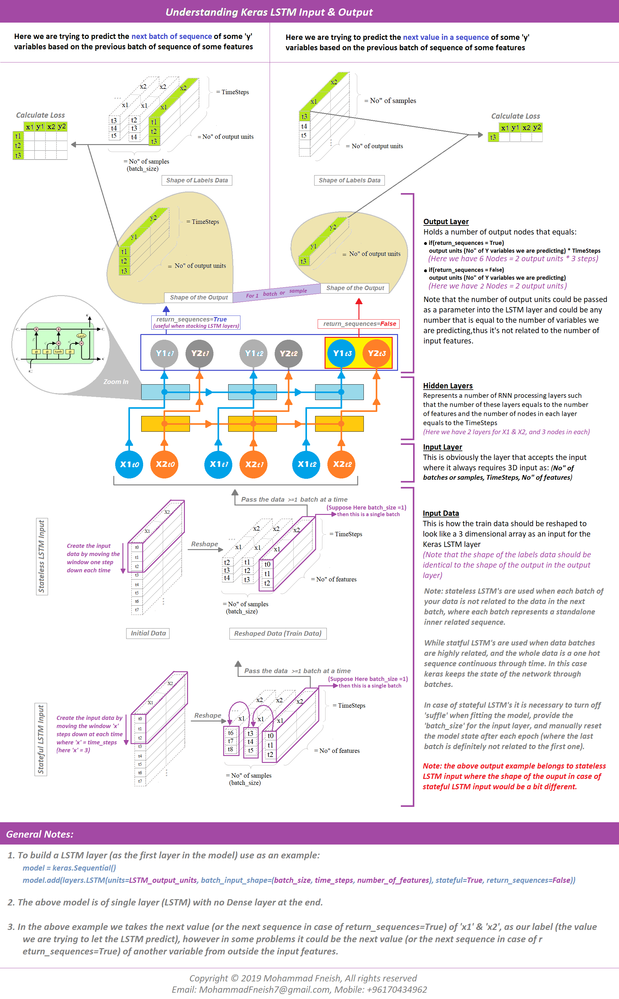

this image has been downloaded from this link:- https://github.com/MohammadFneish7/Keras_LSTM_Diagram

#### Inorder to use the LSTM we need to define our model with the three input, so we need to reshape the data always when using the LSTM model from the keras

In [21]:
# reshape input to be [samples, time steps, features]
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

In [22]:
X_train.shape, X_test.shape

((742, 100, 1), (315, 100, 1))

# Creating the model

In [23]:
model = Sequential() #initialising the sequential model, we will be adding layers on it
model.add(LSTM(50, return_sequences = True , input_shape = (100,1))) # adding the layer of the LSTM with the input shape should be the timestamp and feature
model.add(Dropout(0.3)) # regularizetion inorder to prevent from overfitting
model.add(LSTM(50, return_sequences = True))
model.add(Dropout(0.3))
model.add(LSTM(50))
model.add(Dropout(0.3))
model.add(Dense(1)) # output layer
model.compile(loss = 'mean_squared_error', optimizer = 'adam')

In [24]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 100, 50)           10400     
_________________________________________________________________
dropout (Dropout)            (None, 100, 50)           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 100, 50)           20200     
_________________________________________________________________
dropout_1 (Dropout)          (None, 100, 50)           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dropout_2 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense (Dense)                (None, 1)                 5

In [25]:
model.fit(X_train,y_train,validation_data=(X_test,y_test),epochs=100,batch_size=64,verbose=1)

Epoch 1/100
12/12 [==============================] - 2s 181ms/step - loss: 0.0111 - val_loss: 0.0591
Epoch 2/100
12/12 [==============================] - 1s 92ms/step - loss: 0.0032 - val_loss: 0.0258
Epoch 3/100
12/12 [==============================] - 1s 89ms/step - loss: 0.0013 - val_loss: 0.0224
Epoch 4/100
12/12 [==============================] - 1s 89ms/step - loss: 9.8466e-04 - val_loss: 0.0229
Epoch 5/100
12/12 [==============================] - 1s 110ms/step - loss: 8.5911e-04 - val_loss: 0.0213
Epoch 6/100
12/12 [==============================] - 1s 103ms/step - loss: 8.4702e-04 - val_loss: 0.0207
Epoch 7/100
12/12 [==============================] - 1s 116ms/step - loss: 7.9247e-04 - val_loss: 0.0203
Epoch 8/100
12/12 [==============================] - 1s 113ms/step - loss: 7.6543e-04 - val_loss: 0.0198
Epoch 9/100
12/12 [==============================] - 1s 116ms/step - loss: 7.6571e-04 - val_loss: 0.0196
Epoch 10/100
12/12 [==============================] - 2s 130ms/step - 

Epoch 79/100
12/12 [==============================] - 1s 89ms/step - loss: 2.9933e-04 - val_loss: 0.0097
Epoch 80/100
12/12 [==============================] - 1s 89ms/step - loss: 3.2248e-04 - val_loss: 0.0118
Epoch 81/100
12/12 [==============================] - 1s 89ms/step - loss: 3.2778e-04 - val_loss: 0.0116
Epoch 82/100
12/12 [==============================] - 1s 89ms/step - loss: 3.2397e-04 - val_loss: 0.0102
Epoch 83/100
12/12 [==============================] - 1s 88ms/step - loss: 2.9843e-04 - val_loss: 0.0106
Epoch 84/100
12/12 [==============================] - 1s 89ms/step - loss: 2.8952e-04 - val_loss: 0.0097
Epoch 85/100
12/12 [==============================] - 1s 89ms/step - loss: 2.8516e-04 - val_loss: 0.0093
Epoch 86/100
12/12 [==============================] - 1s 89ms/step - loss: 2.9654e-04 - val_loss: 0.0100
Epoch 87/100
12/12 [==============================] - 1s 89ms/step - loss: 2.8276e-04 - val_loss: 0.0101
Epoch 88/100
12/12 [==============================] - 1

In [26]:
# lets predict the value and analyse the performance of the model
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

In [27]:
#Transforming the dataset into original data
train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)

In [28]:
# Calculating the RMSE metrix for the performance test
math.sqrt(mean_squared_error(y_train, train_predict))

160.52187209410303

In [29]:
math.sqrt(mean_squared_error(y_test, test_predict))

267.2479874191921

# Visualising the Result

In [35]:
df1 = scaler.inverse_transform(df)
df1

array([[107.33 ],
       [107.23 ],
       [108.61 ],
       ...,
       [127.81 ],
       [128.7  ],
       [126.655]])

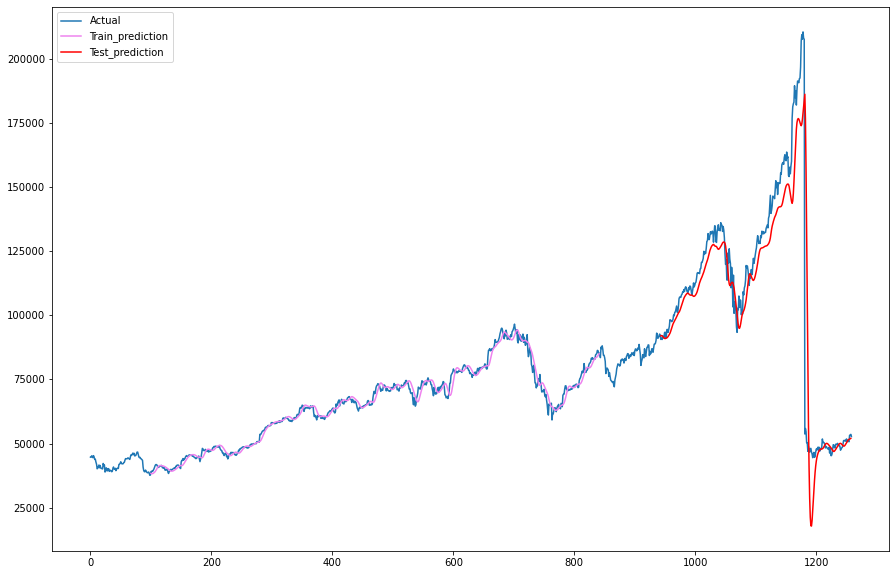

In [42]:
#plotting the dataframe, train data and the prediction
# shift train predictions for plotting
train_pred = np.empty_like(df1) # creating a new array with the same shape and type as df1
train_pred[:, :] = np.nan # assigning nan value to all the values of the array
train_pred[timestamp_size:len(train_predict)+timestamp_size, :] = scaler.inverse_transform(train_predict) # adding the train_predict value in the position shifted from the timestamp_size
# shift test predictions for plotting
test_pred = np.empty_like(df1)
test_pred[:, :] = np.nan
test_pred[len(train_predict)+(timestamp_size*2)+1:len(df1)-1, :] = scaler.inverse_transform(test_predict) # same as training but here 2 times timestam_size because len(train_predict) + timestamp_size+timestamp_size 
# plot baseline and predictions
plt.figure(figsize = (15,10))
plt.plot(scaler.inverse_transform(df1)) # plotting the original value(actual value)
plt.plot(train_pred, color = 'violet')
plt.plot(test_pred,  color = 'red')
plt.legend(['Actual','Train_prediction','Test_prediction'])
plt.show()

# Predicting for the next 30 days

In [61]:
# creating the input of 100 days value to predict the next value
x_input=test_df[316:].reshape(1,-1)
print(x_input.shape)
x_input

(1, 100)


array([[0.70816597, 0.80505111, 0.83081179, 0.83781118, 0.8416356 ,
        0.87858088, 0.85173782, 0.86727601, 0.83502105, 0.86999399,
        0.88923632, 0.88825015, 0.8853638 , 0.89455201, 0.89594708,
        0.92064943, 0.97929044, 0.99360192, 0.98366807, 1.        ,
        0.98544799, 0.9834997 , 0.09308479, 0.10544799, 0.09876127,
        0.07345761, 0.07365003, 0.05407096, 0.06489477, 0.0556825 ,
        0.05209862, 0.06016837, 0.06061335, 0.0524113 , 0.04810583,
        0.03968731, 0.04748046, 0.05164161, 0.04036079, 0.04300661,
        0.0527721 , 0.05921828, 0.05712568, 0.06126278, 0.06361996,
        0.05455201, 0.06292243, 0.05488876, 0.05950692, 0.05924233,
        0.06405292, 0.08192423, 0.07398677, 0.07420325, 0.07304871,
        0.06898376, 0.06167168, 0.06535177, 0.06381239, 0.06111846,
        0.0594107 , 0.05943476, 0.06316296, 0.05017438, 0.06008419,
        0.044546  , 0.04432952, 0.04834636, 0.05919423, 0.06900782,
        0.06819002, 0.06248948, 0.06164762, 0.07

In [64]:
#creating the temporary list to extend out list by adding new predicted value to predict the new value
temp_input=list(x_input)
temp_input=temp_input[0].tolist()
temp_input

[0.7081659651232712,
 0.8050511124473845,
 0.830811785929044,
 0.8378111846061336,
 0.841635598316296,
 0.8785808779314492,
 0.8517378232110644,
 0.8672760072158752,
 0.8350210463018641,
 0.8699939867708961,
 0.8892363199037885,
 0.8882501503307276,
 0.8853638003607938,
 0.89455201443175,
 0.8959470835838845,
 0.9206494287432352,
 0.9792904389657247,
 0.9936019242333134,
 0.9836680697534577,
 1.0,
 0.9854479855682503,
 0.983499699338545,
 0.09308478653036678,
 0.10544798556825014,
 0.09876127480457003,
 0.07345760673481655,
 0.07365003006614551,
 0.05407095610342749,
 0.06489476849067943,
 0.055682501503307225,
 0.052098616957306054,
 0.0601683704149128,
 0.06061334936861096,
 0.05241130487071555,
 0.04810583283223091,
 0.03968731208659049,
 0.04748045700541187,
 0.05164161154539987,
 0.04036079374624174,
 0.04300661455201443,
 0.05277209861695731,
 0.05921828021647624,
 0.05712567648827421,
 0.06126277811184605,
 0.06361996392062536,
 0.05455201443174984,
 0.062922429344558,
 0.054888

In [76]:
# predicting for next 30 days
lst_output=[] # creating the empty list to add the predicted values
n_steps=100 # to give the input feature of 100
i=0 # to run the loop
while(i<30):
    
    if(len(temp_input)>100):
        #print(temp_input)
        x_input=np.array(temp_input[1:]) # converting the list from 1(we need to take new predicted value so we are living the position 0 value and taking the last predicted value for the input of next prediction) to array
        print("{} day input {}".format(i,x_input)) # printing the input value
        x_input=x_input.reshape(1,-1) # reshaping the array to create 2D array
        x_input = x_input.reshape((1, n_steps, 1)) # converting array to 3D beacause LSTM in keras required 3D array as input
        #print(x_input)
        yhat = model.predict(x_input, verbose=0) # predicting the yhat
        print("{} day output {}".format(i,yhat)) # printing the predicted value
        temp_input.extend(yhat[0].tolist()) # adding the predicted value to the last position of the list
        temp_input=temp_input[1:] # taking the last 101 value because after extending it will be 102 so to run this if condition in loop we are removing 1 value from the beginning here
        #print(temp_input)
        lst_output.extend(yhat.tolist()) # adding the predicted value to the list so that we can see all the predicted value at last together
        i=i+1
    else: # this runs for the first time only
        x_input = x_input.reshape((1, n_steps,1)) #reshaping the array
        yhat = model.predict(x_input, verbose=0) # predicting the value
        temp_input.extend(yhat[0].tolist()) # adding it to the list
        print(len(temp_input))
        lst_output.extend(yhat.tolist()) # adding to the output list to show the prediction at last
        i=i+1
    

print(lst_output)

0 day input [0.0791341  0.0771377  0.07562237 0.09029465 0.09012628 0.09226699
 0.08734817 0.08629438 0.08775426 0.08896261 0.08992847 0.09070624
 0.09135853 0.09193826 0.09248297 0.09301579 0.0935489  0.09408738
 0.09463238 0.09518326 0.09573887 0.09629818 0.09686047 0.09742534
 0.09799264 0.09856232 0.09913444 0.09970902 0.1002861  0.10086567
 0.10144772 0.10203221 0.1026191  0.10320833 0.10379988 0.10439368
 0.10498971 0.10558793 0.1061883  0.1067908  0.1073954  0.10800208
 0.10861081 0.10922158 0.10983435 0.11044912 0.11106585 0.11168454
 0.11230514 0.11292767 0.11355206 0.11417833 0.11480643 0.11543635
 0.11606806 0.11670154 0.11733676 0.11797369 0.11861233 0.11925262
 0.11989456 0.1205381  0.12118323 0.12182991 0.12247811 0.12312782
 0.12377898 0.1244316  0.12508561 0.12574099 0.12639771 0.12705575
 0.12771507 0.12837563 0.1290374  0.12970035 0.13036445 0.13102964
 0.13169593 0.13236323 0.13303155 0.13370083 0.13437104 0.13504215
 0.13571411 0.13638689 0.13706045 0.13773474 0.138

11 day output [[0.15403514]]
12 day input [0.09135853 0.09193826 0.09248297 0.09301579 0.0935489  0.09408738
 0.09463238 0.09518326 0.09573887 0.09629818 0.09686047 0.09742534
 0.09799264 0.09856232 0.09913444 0.09970902 0.1002861  0.10086567
 0.10144772 0.10203221 0.1026191  0.10320833 0.10379988 0.10439368
 0.10498971 0.10558793 0.1061883  0.1067908  0.1073954  0.10800208
 0.10861081 0.10922158 0.10983435 0.11044912 0.11106585 0.11168454
 0.11230514 0.11292767 0.11355206 0.11417833 0.11480643 0.11543635
 0.11606806 0.11670154 0.11733676 0.11797369 0.11861233 0.11925262
 0.11989456 0.1205381  0.12118323 0.12182991 0.12247811 0.12312782
 0.12377898 0.1244316  0.12508561 0.12574099 0.12639771 0.12705575
 0.12771507 0.12837563 0.1290374  0.12970035 0.13036445 0.13102964
 0.13169593 0.13236323 0.13303155 0.13370083 0.13437104 0.13504215
 0.13571411 0.13638689 0.13706045 0.13773474 0.13840975 0.13908541
 0.13976172 0.14043859 0.14111601 0.14179392 0.14247233 0.14315113
 0.14383033 0.144509

23 day input [0.09742534 0.09799264 0.09856232 0.09913444 0.09970902 0.1002861
 0.10086567 0.10144772 0.10203221 0.1026191  0.10320833 0.10379988
 0.10439368 0.10498971 0.10558793 0.1061883  0.1067908  0.1073954
 0.10800208 0.10861081 0.10922158 0.10983435 0.11044912 0.11106585
 0.11168454 0.11230514 0.11292767 0.11355206 0.11417833 0.11480643
 0.11543635 0.11606806 0.11670154 0.11733676 0.11797369 0.11861233
 0.11925262 0.11989456 0.1205381  0.12118323 0.12182991 0.12247811
 0.12312782 0.12377898 0.1244316  0.12508561 0.12574099 0.12639771
 0.12705575 0.12771507 0.12837563 0.1290374  0.12970035 0.13036445
 0.13102964 0.13169593 0.13236323 0.13303155 0.13370083 0.13437104
 0.13504215 0.13571411 0.13638689 0.13706045 0.13773474 0.13840975
 0.13908541 0.13976172 0.14043859 0.14111601 0.14179392 0.14247233
 0.14315113 0.14383033 0.14450985 0.14518967 0.14586978 0.14655007
 0.14723055 0.14791115 0.14859182 0.14927255 0.14995328 0.15063396
 0.15131454 0.15199499 0.1526753  0.15335533 0.1540

In [77]:
hundred_days_input=np.arange(1,101) # to add the data we are just adding the number
thirty_day_future=np.arange(101,131) # next 30 days 

In [78]:
len(df1)

1259

In [79]:
len(lst_output)

30

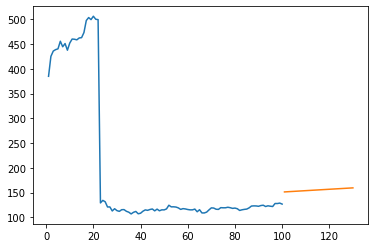

In [83]:
# Now plotting the last 100 days value and the future 30 days prediction
plt.plot(hundred_days_input,df1[1159:]) # plotting the 100 days input data
plt.plot(thirty_day_future,scaler.inverse_transform(lst_output)) # plotting the 30 days prediction

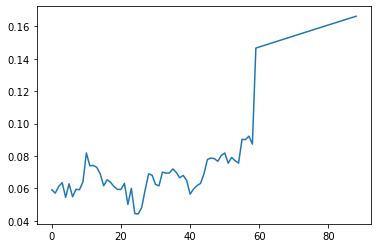

In [86]:
# Plotting the input and predicted data after combining them
df2=df.tolist() # creating the list of input dataset
df2.extend(lst_output) # extending the list with future predicted data
plt.plot(df2[1200:]) #plotting the data

In [87]:
df2=scaler.inverse_transform(df2).tolist() #getting back the original data

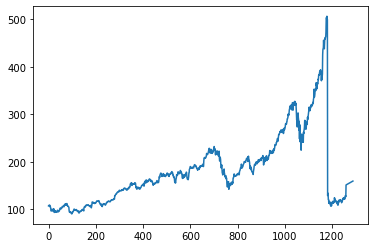

In [89]:
plt.plot(df2) # plotting the original data plus the 30 days prediction